# Exploratory Data Analysis

In [0]:
# Read a CSV file into a DataFrame using Spark
data = spark.read.csv(
    '/FileStore/tables/coffee_Full.csv',  # Path to the CSV file
    header=True,                          # Use the first line as headers
    inferSchema=True                      # Infer data types automatically
)

# Display the DataFrame in a Databricks notebook
display(data)


_c0,transaction_id,age,income,sex,rewards_member,occupation,num_items,purchase_method,wait_time,purchase_amount,store_location,transaction_time,day_of_week
1,1,48,$50K-$75K,Female,false,Retired,3,Credit Card,4.37041779796359,15.19,Uptown,22,Saturday
2,2,32,$25K-$50K,Female,false,Retired,3,Cash,2.30796121678142,12.41,Midtown,20,Friday
3,3,68,$75K-$100K,Female,false,Self Employed,4,Mobile Payment,3.89939822873409,18.16,Midtown,12,Friday
4,4,31,$25K-$50K,Female,false,Employed,4,Mobile Payment,1.87190761759261,15.41,Downtown,14,Sunday
5,5,20,Under $25K,Female,false,Student,1,Credit Card,2.66648236799237,6.23,Uptown,18,Wednesday
6,6,59,$75K-$100K,Female,true,Employed,5,Credit Card,2.50637046034456,21.72,Midtown,13,Monday
7,7,67,$75K-$100K,Male,true,Self Employed,3,Credit Card,0.966888079743862,13.08,Uptown,12,Saturday
8,8,71,Over $100K,Female,false,Retired,3,Credit Card,3.42676111896725,14.96,Downtown,13,Saturday
9,9,60,$75K-$100K,Male,true,Retired,6,Credit Card,2.94511204259134,19.27,Downtown,11,Wednesday
10,10,54,$75K-$100K,Male,true,Employed,3,Credit Card,0.853794802025569,13.38,Midtown,16,Friday


## Histogram for Age Distribution

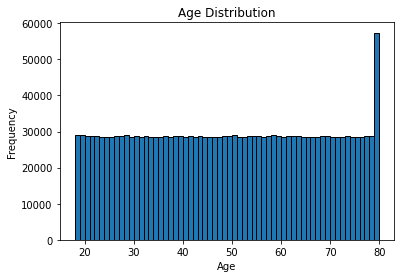

In [0]:
import matplotlib.pyplot as plt

# Extract 'age' data from the DataFrame, convert to RDD, flatten, and collect in a list
age_data = data.select('age').rdd.flatMap(lambda x: x).collect()

# Plot a histogram of the age data
plt.hist(age_data, bins=62, edgecolor='black')  # Specify number of bins and edge color
plt.xlabel('Age')                               # Label for the x-axis
plt.ylabel('Frequency')                         # Label for the y-axis
plt.title('Age Distribution')                   # Title of the histogram
plt.show()                                      # Display the plot


## Bar Plot for Income Distribution

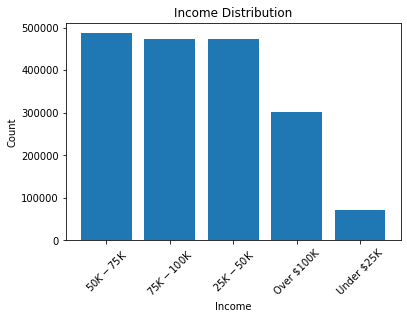

In [0]:
import matplotlib.pyplot as plt

# Group data by 'income', count occurrences, sort in descending order by count,
# and convert to a Pandas DataFrame
income_counts = data.groupBy('income').count().orderBy('count', ascending=False).toPandas()

# Plot the results as a bar chart
plt.bar(income_counts['income'], income_counts['count'])  # Plot 'income' vs 'count'
plt.xlabel('Income')                                      # Label for the x-axis
plt.ylabel('Count')                                       # Label for the y-axis
plt.title('Income Distribution')                          # Title of the bar chart
plt.xticks(rotation=45)                                   # Rotate x-axis labels for better readability
plt.show()                                                # Display the plot


## Box Plot for Wait Distribution

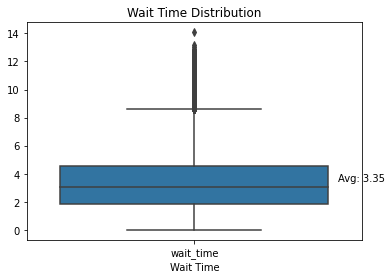

In [0]:
import seaborn as sns
import matplotlib.pyplot as plt

# Convert a Spark DataFrame column to a Pandas DataFrame
wait_time_df = data.select('wait_time').toPandas()

# Calculate the average wait time from the DataFrame
average_wait_time = wait_time_df['wait_time'].mean()

# Set up the figure size for the plot
plt.figure(figsize=(6, 4))

# Create a boxplot to visualize the distribution of wait times
sns.boxplot(data=wait_time_df)
plt.xlabel('Wait Time')                     # Label for the x-axis
plt.title('Wait Time Distribution')         # Title of the plot

# Overlay the average wait time as a text annotation on the plot
plt.text(
    0.5, average_wait_time, f'Avg: {average_wait_time:.2f}',  # Position and string formatting
    ha='center', va='bottom',                                # Horizontal and vertical alignment
    fontsize=10, color='black'                               # Font size and color
)

# Display the plot
plt.show()


## Scatter Plot for Age vs. Purchase Amount

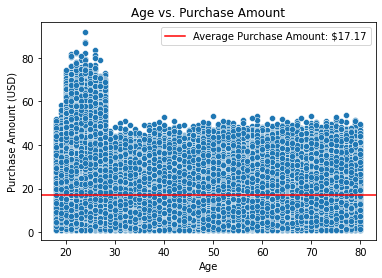

In [0]:
import matplotlib.pyplot as plt
import seaborn as sns

# Convert selected columns from Spark DataFrame to Pandas DataFrame
age_purchase_df = data.select('age', 'purchase_amount').toPandas()

# Calculate the average purchase amount
average_purchase_amount = age_purchase_df['purchase_amount'].mean()

# Create a scatter plot to visualize the relationship between age and purchase amount
sns.scatterplot(data=age_purchase_df, x='age', y='purchase_amount')
plt.axhline(
    y=average_purchase_amount, 
    color='r', 
    linestyle='-', 
    label=f'Average Purchase Amount: ${average_purchase_amount:.2f}'  # Label with formatted string
)
plt.xlabel('Age')                                  # Label for the x-axis
plt.ylabel('Purchase Amount (USD)')                # Label for the y-axis
plt.title('Age vs. Purchase Amount')               # Title of the plot
plt.legend()                                       # Show legend
plt.show()                                         # Display the plot


## Heatmap for Correlation Matrix

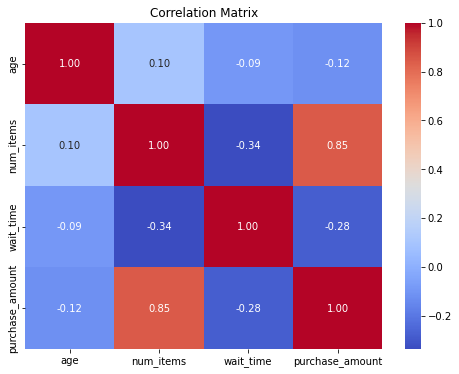

In [0]:
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from pyspark.ml.stat import Correlation
from pyspark.ml.feature import VectorAssembler

# Assemble data into vectors for correlation analysis
vector_assembler = VectorAssembler(
    inputCols=['age', 'num_items', 'wait_time', 'purchase_amount'], 
    outputCol='features'
)
df_vectored = vector_assembler.transform(data)  # Transform the data

# Calculate correlation matrix using the transformed data
df_corr = Correlation.corr(df_vectored, 'features').head()

# Convert the correlation matrix from Spark DataFrame to a Pandas DataFrame for visualization
corr_matrix = df_corr[0].toArray()  # Convert to array
columns = ['age', 'num_items', 'wait_time', 'purchase_amount']  # Column names
corr_df = pd.DataFrame(corr_matrix, columns=columns, index=columns)

# Plot the correlation matrix as a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(corr_df, annot=True, cmap='coolwarm', fmt=".2f")  # Annotated heatmap

# Customize ticks for better readability
num_vars = len(columns)
plt.xticks(ticks=np.arange(num_vars) + 0.5, labels=columns, ha='center')
plt.yticks(ticks=np.arange(num_vars) + 0.5, labels=columns, va='center')

# Add a title and display the plot
plt.title('Correlation Matrix')
plt.show()


## Pie Chart for Gender Distribution

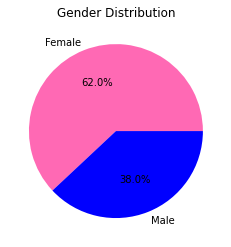

In [0]:
import matplotlib.pyplot as plt

# Group data by 'sex' column, count occurrences, and convert to Pandas DataFrame
gender_counts = data.groupBy('sex').count().toPandas()

# Define colors for different genders
colors = {'Female': 'hotpink', 'Male': 'blue'}

# Create a pie chart to visualize the gender distribution
plt.pie(
    gender_counts['count'], 
    labels=gender_counts['sex'], 
    autopct='%1.1f%%', 
    colors=[colors[gender] for gender in gender_counts['sex']]  # Assign colors based on gender
)
plt.title('Gender Distribution')  # Title of the pie chart
plt.show()  # Display the plot


## Line Plot for Weekly Transaction Trend

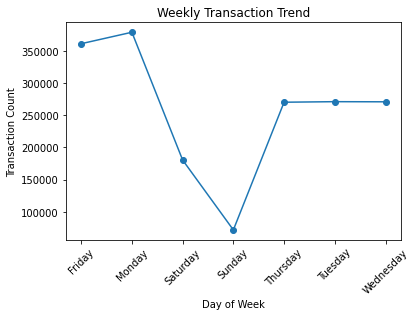

In [0]:
import matplotlib.pyplot as plt

# Group data by 'day_of_week', count occurrences, sort by 'day_of_week', and convert to Pandas DataFrame
weekly_counts = data.groupBy('day_of_week').count().orderBy('day_of_week').toPandas()

# Create a line plot of weekly transaction counts
plt.plot(
    weekly_counts['day_of_week'], 
    weekly_counts['count'], 
    marker='o'  # Use circle markers on each data point
)
plt.xlabel('Day of Week')           # Label for the x-axis
plt.ylabel('Transaction Count')     # Label for the y-axis
plt.title('Weekly Transaction Trend')  # Title of the plot
plt.xticks(rotation=45)             # Rotate x-axis labels for better readability
plt.show()                          # Display the plot


## Pie Chart of Purchase Methods

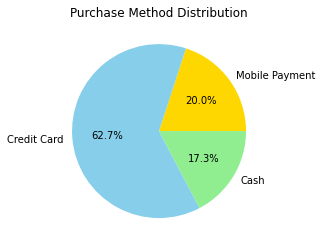

In [0]:
import matplotlib.pyplot as plt

# Group data by 'purchase_method', count occurrences, and convert to Pandas DataFrame
purchase_method_counts = data.groupBy('purchase_method').count().toPandas()

# Define custom colors for different purchase methods
colors = {
    'Cash': 'lightgreen', 
    'Credit Card': 'skyblue', 
    'Mobile Payment': 'gold'
}

# Create a pie chart to visualize the distribution of purchase methods
plt.pie(
    purchase_method_counts['count'], 
    labels=purchase_method_counts['purchase_method'], 
    autopct='%1.1f%%', 
    colors=[colors[method] for method in purchase_method_counts['purchase_method']]  # Map colors to methods
)
plt.title('Purchase Method Distribution')  # Title of the pie chart
plt.show()  # Display the plot


## Bar Graph for Wait Time by Location

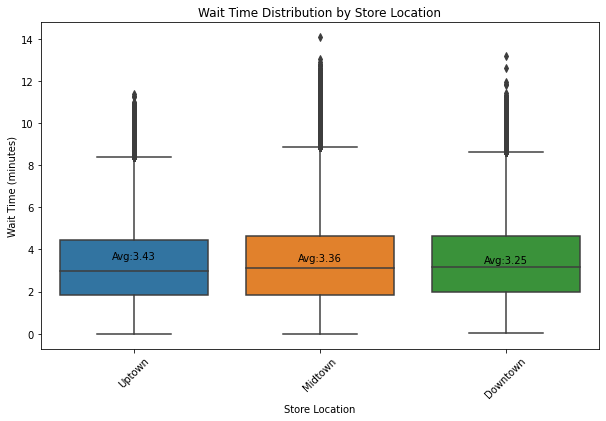

In [0]:
import seaborn as sns
import matplotlib.pyplot as plt

# Select 'wait_time' and 'store_location' columns from the DataFrame and convert to Pandas DataFrame
wait_time_location_df = data.select('wait_time', 'store_location').toPandas()

# Calculate the average wait time for each store location
average_wait_time = wait_time_location_df.groupby('store_location')['wait_time'].mean()

# Create a box plot to visualize the distribution of wait times across store locations
plt.figure(figsize=(10, 6))
ax = sns.boxplot(data=wait_time_location_df, x='store_location', y='wait_time')

# Overlay the average wait time as a text annotation on each box in the plot
for i, (loc, avg_time) in enumerate(average_wait_time.items()):
    ax.text(
        i, avg_time, f'Avg:{avg_time:.2f}',  # Position, string and formatting
        ha='center', va='bottom',           # Horizontal and vertical alignment
        fontsize=10, color='black'          # Font size and color
    )

plt.xlabel('Store Location')             # Label for the x-axis
plt.ylabel('Wait Time (minutes)')        # Label for the y-axis
plt.title('Wait Time Distribution by Store Location')  # Title of the plot
plt.xticks(rotation=45)                  # Rotate x-axis labels for better readability
plt.show()                               # Display the plot


# Feature Engineering

## K-Means Clustering

In [0]:
from pyspark.ml.feature import VectorAssembler

# Create an instance of VectorAssembler
# inputCols: A list of column names to be assembled into a single vector column
# outputCol: The name of the output column that will contain the assembled features
assembler = VectorAssembler(
    inputCols=["age", "num_items", "purchase_amount"], 
    outputCol="features"
)

# Apply the VectorAssembler transformation to the input DataFrame
# The assembled features will be stored in a new column named "features"
df_features = assembler.transform(data)


In [0]:
from pyspark.ml.clustering import KMeans

# Create an instance of the KMeans model
# featuresCol: The name of the input column containing the features
# k: The number of clusters to form
kmeans = KMeans(featuresCol="features", k=5)

# Train the KMeans model on the input DataFrame
# The resulting trained model is assigned to the variable 'model'
model = kmeans.fit(df_features)

# Make predictions using the trained KMeans model
# The cluster predictions are added as a new column to the input DataFrame
# The resulting DataFrame with predictions is assigned to 'df_predictions'
df_predictions = model.transform(df_features)


In [0]:
# Select specific columns from the DataFrame for visualization
# The selected columns are "age", "purchase_amount", "prediction", and "num_items"
# The resulting DataFrame is passed to the 'display' function for visualization
display(df_predictions.select("age", "purchase_amount", "prediction", "num_items"))


age,purchase_amount,prediction,num_items
48,15.19,2,3
32,12.41,0,3
68,18.16,1,4
31,15.41,0,4
20,6.23,0,1
59,21.72,3,5
67,13.08,1,3
71,14.96,1,3
60,19.27,3,6
54,13.38,2,3


## Finding RMSE for the Tree Methods

In [0]:
from pyspark.ml.feature import VectorAssembler

# Access the list of column names in the 'data' DataFrame
# The 'columns' attribute returns an array of column names
data.columns


Out[199]: ['_c0',
 'transaction_id',
 'age',
 'income',
 'sex',
 'rewards_member',
 'occupation',
 'num_items',
 'purchase_method',
 'wait_time',
 'purchase_amount',
 'store_location',
 'transaction_time',
 'day_of_week']

In [0]:
# Select specific columns from the DataFrame using slicing and concatenation
# The selected columns are:
#   - Columns at index 1 and 2 (df.columns[1:3])
#   - Column at index 7 (df.columns[7])
#   - Columns at index 9 and 10 (df.columns[9:11])
#   - Column at index 12 (df.columns[12])
# The selected column names are stored in the 'feat' variable
feat = df.columns[1:3] + [df.columns[7]] + df.columns[9:11] + [df.columns[12]]

# Print the selected column names
print(feat)


['transaction_id', 'age', 'num_items', 'wait_time', 'purchase_amount', 'transaction_time']


In [0]:
from pyspark.ml.feature import VectorAssembler

# Create an instance of VectorAssembler
# inputCols: The list of column names to be assembled into a single vector column
#            The column names are stored in the 'feat' variable
# outputCol: The name of the output column that will contain the assembled features
assembler = VectorAssembler(inputCols=feat, outputCol='features')


In [0]:
# Apply the VectorAssembler transformation to the input DataFrame
# The assembled features will be stored in a new column named 'features'
# The resulting DataFrame with the assembled features is assigned to 'output'
output = assembler.transform(df)

# Display the 'output' DataFrame using Databricks' built-in visualization
# The 'display' function renders the DataFrame as an interactive table or chart
display(output)


_c0,transaction_id,age,income,sex,rewards_member,occupation,num_items,purchase_method,wait_time,purchase_amount,store_location,transaction_time,day_of_week,features
1,1,48,$50K-$75K,Female,false,false,3,Credit Card,4.37041779796359,15.19,Uptown,22,Saturday,"Map(vectorType -> dense, length -> 6, values -> List(1.0, 48.0, 3.0, 4.37041779796359, 15.19, 22.0))"
2,2,32,$25K-$50K,Female,false,false,3,Cash,2.30796121678142,12.41,Midtown,20,Friday,"Map(vectorType -> dense, length -> 6, values -> List(2.0, 32.0, 3.0, 2.30796121678142, 12.41, 20.0))"
3,3,68,$75K-$100K,Female,false,false,4,Mobile Payment,3.89939822873409,18.16,Midtown,12,Friday,"Map(vectorType -> dense, length -> 6, values -> List(3.0, 68.0, 4.0, 3.89939822873409, 18.16, 12.0))"
4,4,31,$25K-$50K,Female,false,false,4,Mobile Payment,1.87190761759261,15.41,Downtown,14,Sunday,"Map(vectorType -> dense, length -> 6, values -> List(4.0, 31.0, 4.0, 1.87190761759261, 15.41, 14.0))"
5,5,20,Under $25K,Female,false,true,1,Credit Card,2.66648236799237,6.23,Uptown,18,Wednesday,"Map(vectorType -> dense, length -> 6, values -> List(5.0, 20.0, 1.0, 2.66648236799237, 6.23, 18.0))"
6,6,59,$75K-$100K,Female,true,false,5,Credit Card,2.50637046034456,21.72,Midtown,13,Monday,"Map(vectorType -> dense, length -> 6, values -> List(6.0, 59.0, 5.0, 2.50637046034456, 21.72, 13.0))"
7,7,67,$75K-$100K,Male,true,false,3,Credit Card,0.966888079743862,13.08,Uptown,12,Saturday,"Map(vectorType -> dense, length -> 6, values -> List(7.0, 67.0, 3.0, 0.966888079743862, 13.08, 12.0))"
8,8,71,Over $100K,Female,false,false,3,Credit Card,3.42676111896725,14.96,Downtown,13,Saturday,"Map(vectorType -> dense, length -> 6, values -> List(8.0, 71.0, 3.0, 3.42676111896725, 14.96, 13.0))"
9,9,60,$75K-$100K,Male,true,false,6,Credit Card,2.94511204259134,19.27,Downtown,11,Wednesday,"Map(vectorType -> dense, length -> 6, values -> List(9.0, 60.0, 6.0, 2.94511204259134, 19.27, 11.0))"
10,10,54,$75K-$100K,Male,true,false,3,Credit Card,0.853794802025569,13.38,Midtown,16,Friday,"Map(vectorType -> dense, length -> 6, values -> List(10.0, 54.0, 3.0, 0.853794802025569, 13.38, 16.0))"


In [0]:
from pyspark.sql.types import StringType

# Cast the "rewards_member" column to StringType
# The 'withColumn' method is used to create a new column or replace an existing column
# The 'cast' method is used to convert the data type of the column to StringType
# The resulting DataFrame with the updated "rewards_member" column is assigned back to 'output'
output = output.withColumn("rewards_member", output["rewards_member"].cast(StringType()))


In [0]:
from pyspark.ml.feature import StringIndexer

# Create an instance of StringIndexer
# inputCol: The name of the input column to be indexed
#           In this case, the input column is 'rewards_member'
# outputCol: The name of the output column that will contain the indexed values
#            In this case, the output column is named 'rewards_memberIndex'
indexer = StringIndexer(inputCol='rewards_member', outputCol='rewards_memberIndex')


In [0]:
# Fit the StringIndexer on the 'output' DataFrame and transform the data
# The 'fit' method learns the index mappings based on the 'rewards_member' column
# The 'transform' method applies the learned index mappings to the 'output' DataFrame
# The resulting DataFrame with the indexed 'rewards_memberIndex' column is assigned to 'output_fixed'
output_fixed = indexer.fit(output).transform(output)

# Display the 'output_fixed' DataFrame using Databricks' built-in visualization
# The 'display' function renders the DataFrame as an interactive table or chart
display(output_fixed)


_c0,transaction_id,age,income,sex,rewards_member,occupation,num_items,purchase_method,wait_time,purchase_amount,store_location,transaction_time,day_of_week,features,rewards_memberIndex
1,1,48,$50K-$75K,Female,false,false,3,Credit Card,4.37041779796359,15.19,Uptown,22,Saturday,"Map(vectorType -> dense, length -> 6, values -> List(1.0, 48.0, 3.0, 4.37041779796359, 15.19, 22.0))",0.0
2,2,32,$25K-$50K,Female,false,false,3,Cash,2.30796121678142,12.41,Midtown,20,Friday,"Map(vectorType -> dense, length -> 6, values -> List(2.0, 32.0, 3.0, 2.30796121678142, 12.41, 20.0))",0.0
3,3,68,$75K-$100K,Female,false,false,4,Mobile Payment,3.89939822873409,18.16,Midtown,12,Friday,"Map(vectorType -> dense, length -> 6, values -> List(3.0, 68.0, 4.0, 3.89939822873409, 18.16, 12.0))",0.0
4,4,31,$25K-$50K,Female,false,false,4,Mobile Payment,1.87190761759261,15.41,Downtown,14,Sunday,"Map(vectorType -> dense, length -> 6, values -> List(4.0, 31.0, 4.0, 1.87190761759261, 15.41, 14.0))",0.0
5,5,20,Under $25K,Female,false,true,1,Credit Card,2.66648236799237,6.23,Uptown,18,Wednesday,"Map(vectorType -> dense, length -> 6, values -> List(5.0, 20.0, 1.0, 2.66648236799237, 6.23, 18.0))",0.0
6,6,59,$75K-$100K,Female,true,false,5,Credit Card,2.50637046034456,21.72,Midtown,13,Monday,"Map(vectorType -> dense, length -> 6, values -> List(6.0, 59.0, 5.0, 2.50637046034456, 21.72, 13.0))",1.0
7,7,67,$75K-$100K,Male,true,false,3,Credit Card,0.966888079743862,13.08,Uptown,12,Saturday,"Map(vectorType -> dense, length -> 6, values -> List(7.0, 67.0, 3.0, 0.966888079743862, 13.08, 12.0))",1.0
8,8,71,Over $100K,Female,false,false,3,Credit Card,3.42676111896725,14.96,Downtown,13,Saturday,"Map(vectorType -> dense, length -> 6, values -> List(8.0, 71.0, 3.0, 3.42676111896725, 14.96, 13.0))",0.0
9,9,60,$75K-$100K,Male,true,false,6,Credit Card,2.94511204259134,19.27,Downtown,11,Wednesday,"Map(vectorType -> dense, length -> 6, values -> List(9.0, 60.0, 6.0, 2.94511204259134, 19.27, 11.0))",1.0
10,10,54,$75K-$100K,Male,true,false,3,Credit Card,0.853794802025569,13.38,Midtown,16,Friday,"Map(vectorType -> dense, length -> 6, values -> List(10.0, 54.0, 3.0, 0.853794802025569, 13.38, 16.0))",1.0


In [0]:
# Select specific columns from the 'output_fixed' DataFrame
# The selected columns are 'features' and 'rewards_memberIndex'
# The resulting DataFrame with only the selected columns is assigned to 'final_data'
final_data = output_fixed.select('features', 'rewards_memberIndex')


In [0]:
# Split the 'final_data' DataFrame into training and testing datasets
# The 'randomSplit' method is used to randomly split the DataFrame into two parts
# The first argument is a list of weights specifying the fraction of data in each split
#   - In this case, 80% of the data is assigned to the training set and 20% to the testing set
# The 'seed' parameter is set to 7 to ensure reproducibility of the random split
# The resulting split DataFrames are assigned to 'train' and 'test' variables
train, test = final_data.randomSplit([0.8, 0.2], seed=7)


In [0]:
from pyspark.ml.regression import LinearRegression

# Create an instance of the LinearRegression model
# labelCol: The name of the column containing the label (target) variable
#           In this case, the label column is 'rewards_memberIndex'
# featuresCol: The name of the column containing the input features
#              In this case, the features column is 'features'
lr = LinearRegression(labelCol='rewards_memberIndex', featuresCol='features')


In [0]:
# Train the LinearRegression model on the training dataset
# The 'fit' method is called on the 'lr' instance, passing the 'train' DataFrame as input
# The trained model is assigned to the 'lrModel' variable
lrModel = lr.fit(train)


In [0]:
# Print the coefficients of the trained linear regression model
# The 'coefficients' attribute of the 'lrModel' contains the coefficients of the model
# The '\n' character is used to add a newline after printing the coefficients
print('Model coefficients are following:', lrModel.coefficients, '\n')

# Print the intercept of the trained linear regression model
# The 'intercept' attribute of the 'lrModel' contains the intercept of the model
print('Model intercept is following:', lrModel.intercept)


Model coefficients are following:  [6.671083009411371e-10,0.0023708641778980855,0.10233034293749292,-0.1108333595891832,0.0026786361528473306,-0.00695587880186336] 

Model intercept is following:  0.29351416263797214


In [0]:
# Access the p-values of the trained linear regression model
# The 'summary' attribute of the 'lrModel' provides access to the model summary
# The 'pValues' attribute of the model summary contains the p-values for each coefficient
# The p-values are stored in the 'lrModel.summary.pValues' attribute
lrModel.summary.pValues


Out[214]: [0.20152466144591408, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]

In [0]:
# Evaluate the trained linear regression model on the test dataset
# The 'evaluate' method is called on the 'lrModel' instance, passing the 'test' DataFrame as input
# The evaluation results are assigned to the 'testResults' variable
testResults = lrModel.evaluate(test)


In [0]:
# Print the Root Mean Squared Error (RMSE) on the test data
# The 'rootMeanSquaredError' attribute of 'testResults' contains the RMSE value
# The RMSE measures the average deviation between the predicted and actual values
print('RMSE on the test data is:', testResults.rootMeanSquaredError)

# Print the R-squared value on the test data
# The 'r2' attribute of 'testResults' contains the R-squared value
# The R-squared value represents the proportion of variance explained by the model
print('R-squared value on the test data is:', testResults.r2)


RMSE on the test data is:  0.32672149260702776
R-squared value on the test data is:  0.5207945616984666


In [0]:
from pyspark.ml.regression import RandomForestRegressor, GBTRegressor, DecisionTreeRegressor

# Create an instance of the DecisionTreeRegressor
# labelCol: The name of the column containing the label (target) variable
#           In this case, the label column is 'rewards_memberIndex'
# featuresCol: The name of the column containing the input features
#              In this case, the features column is 'features'
dtr = DecisionTreeRegressor(labelCol='rewards_memberIndex', featuresCol='features')

# Create an instance of the RandomForestRegressor
# labelCol: The name of the column containing the label (target) variable
#           In this case, the label column is 'rewards_memberIndex'
# featuresCol: The name of the column containing the input features
#              In this case, the features column is 'features'
rfr = RandomForestRegressor(labelCol='rewards_memberIndex', featuresCol='features')

# Create an instance of the GBTRegressor
# labelCol: The name of the column containing the label (target) variable
#           In this case, the label column is 'rewards_memberIndex'
# featuresCol: The name of the column containing the input features
#              In this case, the features column is 'features'
gbr = GBTRegressor(labelCol='rewards_memberIndex', featuresCol='features')


In [0]:
# Train the DecisionTreeRegressor model on the training dataset
# The 'fit' method is called on the 'dtr' instance, passing the 'train' DataFrame as input
# The trained model is assigned to the 'dt_model' variable
dt_model = dtr.fit(train)

# Train the RandomForestRegressor model on the training dataset
# The 'fit' method is called on the 'rfr' instance, passing the 'train' DataFrame as input
# The trained model is assigned to the 'rf_model' variable
rf_model = rfr.fit(train)

# Train the GBTRegressor model on the training dataset
# The 'fit' method is called on the 'gbr' instance, passing the 'train' DataFrame as input
# The trained model is assigned to the 'gb_model' variable
gb_model = gbr.fit(train)


In [0]:
from pyspark.ml.evaluation import RegressionEvaluator

# Make predictions using the trained DecisionTreeRegressor model on the test dataset
# The 'transform' method is called on the 'dt_model' instance, passing the 'test' DataFrame as input
# The predictions are stored in the 'dt_predictions' DataFrame
dt_predictions = dt_model.transform(test)

# Make predictions using the trained RandomForestRegressor model on the test dataset
# The 'transform' method is called on the 'rf_model' instance, passing the 'test' DataFrame as input
# The predictions are stored in the 'rf_predictions' DataFrame
rf_predictions = rf_model.transform(test)

# Make predictions using the trained GBTRegressor model on the test dataset
# The 'transform' method is called on the 'gb_model' instance, passing the 'test' DataFrame as input
# The predictions are stored in the 'gb_predictions' DataFrame
gb_predictions = gb_model.transform(test)


In [0]:
# Create an instance of the RegressionEvaluator
# labelCol: The name of the column containing the true labels (target values)
#           In this case, the label column is 'rewards_memberIndex'
# predictionCol: The name of the column containing the predicted values
#                In this case, the prediction column is 'prediction'
# metricName: The metric to be used for evaluation
#             In this case, the metric is 'rmse' (Root Mean Squared Error)
evaluator = RegressionEvaluator(labelCol='rewards_memberIndex', predictionCol='prediction', metricName='rmse')


In [0]:
# Evaluate the DecisionTreeRegressor model using the RegressionEvaluator
# The 'evaluate' method is called on the 'evaluator' instance, passing the 'dt_predictions' DataFrame as input
# The RMSE value for the DecisionTreeRegressor model is printed
print('Decision Tree RMSE on the test data is following:', evaluator.evaluate(dt_predictions))

# Evaluate the RandomForestRegressor model using the RegressionEvaluator
# The 'evaluate' method is called on the 'evaluator' instance, passing the 'rf_predictions' DataFrame as input
# The RMSE value for the RandomForestRegressor model is printed
print('Random forest RMSE on the test data is following:', evaluator.evaluate(rf_predictions))

# Evaluate the GBTRegressor model using the RegressionEvaluator
# The 'evaluate' method is called on the 'evaluator' instance, passing the 'gb_predictions' DataFrame as input
# The RMSE value for the GBTRegressor model is printed
print('Gradient Boosted Tree RMSE on the test data is following:', evaluator.evaluate(gb_predictions))


Decision Tree RMSE on the test data is following:  0.2919913120550141
Random forest RMSE on the test data is following:  0.2910524029206798
Gradient Boosted Tree RMSE on the test data is following:  0.27310492252447877


In [0]:
# Print the GBTRegressor model
# The 'print' statement displays the details of the trained GBTRegressor model
print(gb_model)

# Print the RandomForestRegressor model
# The 'print' statement displays the details of the trained RandomForestRegressor model
print(rf_model)

# Print the DecisionTreeRegressor model
# The 'print' statement displays the details of the trained DecisionTreeRegressor model
print(dt_model)


GBTRegressionModel: uid=GBTRegressor_0f0a9aae145a, numTrees=20, numFeatures=6
RandomForestRegressionModel: uid=RandomForestRegressor_e113c5aaa6ac, numTrees=20, numFeatures=6
DecisionTreeRegressionModel: uid=DecisionTreeRegressor_7ab718cd14ea, depth=5, numNodes=63, numFeatures=6


In [0]:
from pyspark.ml.classification import DecisionTreeClassifier, RandomForestClassifier, GBTClassifier

# Create an instance of the DecisionTreeClassifier
# labelCol: The name of the column containing the label (target) variable
#           In this case, the label column is 'rewards_memberIndex'
# featuresCol: The name of the column containing the input features
#              In this case, the features column is 'features'
dtc = DecisionTreeClassifier(labelCol='rewards_memberIndex', featuresCol='features')

# Create an instance of the RandomForestClassifier
# labelCol: The name of the column containing the label (target) variable
#           In this case, the label column is 'rewards_memberIndex'
# featuresCol: The name of the column containing the input features
#              In this case, the features column is 'features'
rfc = RandomForestClassifier(labelCol='rewards_memberIndex', featuresCol='features')

# Create an instance of the GBTClassifier
# labelCol: The name of the column containing the label (target) variable
#           In this case, the label column is 'rewards_memberIndex'
# featuresCol: The name of the column containing the input features
#              In this case, the features column is 'features'
gbc = GBTClassifier(labelCol='rewards_memberIndex', featuresCol='features')


In [0]:
# Train the DecisionTreeClassifier model on the training dataset
# The 'fit' method is called on the 'dtc' instance, passing the 'train' DataFrame as input
# The trained model is assigned to the 'dtc_model' variable
dtc_model = dtc.fit(train)

# Train the RandomForestClassifier model on the training dataset
# The 'fit' method is called on the 'rfc' instance, passing the 'train' DataFrame as input
# The trained model is assigned to the 'rfc_model' variable
rfc_model = rfc.fit(train)

# Train the GBTClassifier model on the training dataset
# The 'fit' method is called on the 'gbc' instance, passing the 'train' DataFrame as input
# The trained model is assigned to the 'gbc_model' variable
gbc_model = gbc.fit(train)


In [0]:
# Make predictions using the trained DecisionTreeClassifier model on the test dataset
# The 'transform' method is called on the 'dtc_model' instance, passing the 'test' DataFrame as input
# The predictions are stored in the 'dtc_predictions' DataFrame
dtc_predictions = dtc_model.transform(test)

# Make predictions using the trained RandomForestClassifier model on the test dataset
# The 'transform' method is called on the 'rfc_model' instance, passing the 'test' DataFrame as input
# The predictions are stored in the 'rfc_predictions' DataFrame
rfc_predictions = rfc_model.transform(test)

# Make predictions using the trained GBTClassifier model on the test dataset
# The 'transform' method is called on the 'gbc_model' instance, passing the 'test' DataFrame as input
# The predictions are stored in the 'gbc_predictions' DataFrame
gbc_predictions = gbc_model.transform(test)


In [0]:
from pyspark.ml.evaluation import MulticlassClassificationEvaluator

# Create an instance of the MulticlassClassificationEvaluator
# labelCol: The name of the column containing the true labels (target values)
#           In this case, the label column is 'rewards_memberIndex'
# predictionCol: The name of the column containing the predicted labels
#                In this case, the prediction column is 'prediction'
# metricName: The metric to be used for evaluation
#             In this case, the metric is 'accuracy'
accuracy_eval = MulticlassClassificationEvaluator(labelCol='rewards_memberIndex',
                                                  predictionCol='prediction',
                                                  metricName='accuracy')


In [0]:
# Evaluate the accuracy of the DecisionTreeClassifier model
# The 'evaluate' method is called on the 'accuracy_eval' instance,
# passing the 'dtc_predictions' DataFrame as input
# The accuracy score is assigned to the 'dtc_accuracy' variable
dtc_accuracy = accuracy_eval.evaluate(dtc_predictions)

# Evaluate the accuracy of the RandomForestClassifier model
# The 'evaluate' method is called on the 'accuracy_eval' instance,
# passing the 'rfc_predictions' DataFrame as input
# The accuracy score is assigned to the 'rfc_accuracy' variable
rfc_accuracy = accuracy_eval.evaluate(rfc_predictions)

# Evaluate the accuracy of the GBTClassifier model
# The 'evaluate' method is called on the 'accuracy_eval' instance,
# passing the 'gbc_predictions' DataFrame as input
# The accuracy score is assigned to the 'gbc_accuracy' variable
gbc_accuracy = accuracy_eval.evaluate(gbc_predictions)


In [0]:
# Print the accuracy of the decision tree model
print('decision tree model accuracy is = ', dtc_accuracy, '\n')

# Print the accuracy of the random forest model
print('random forest model accuracy is = ', rfc_accuracy, '\n')

# Print the accuracy of the gradient boosting model
print('gradient boosting model accuracy is = ', gbc_accuracy, '\n')


decision tree model accuracy is =  0.8809721972598195 

random forest model accuracy is =  0.8818155424368528 

gradient boosting model accuracy is =  0.896486983451079 



In [0]:
from pyspark.ml.feature import *

# Read the CSV file "coffee_Full.csv" into a DataFrame
# The file path is "/FileStore/tables/coffee_Full.csv"
# 'inferSchema' is set to True to automatically infer the data types of columns
# 'header' is set to True to use the first row as column names
df = spark.read.csv("/FileStore/tables/coffee_Full.csv", inferSchema=True, header=True)


In [0]:
# Print the schema of the DataFrame
# The 'printSchema' method displays the structure of the DataFrame
# including column names, data types, and nullable information
df.printSchema()


root
 |-- _c0: integer (nullable = true)
 |-- transaction_id: integer (nullable = true)
 |-- age: integer (nullable = true)
 |-- income: string (nullable = true)
 |-- sex: string (nullable = true)
 |-- rewards_member: boolean (nullable = true)
 |-- occupation: string (nullable = true)
 |-- num_items: integer (nullable = true)
 |-- purchase_method: string (nullable = true)
 |-- wait_time: double (nullable = true)
 |-- purchase_amount: double (nullable = true)
 |-- store_location: string (nullable = true)
 |-- transaction_time: integer (nullable = true)
 |-- day_of_week: string (nullable = true)



In [0]:
# Drop rows with null or missing values from the DataFrame
# The 'na.drop()' method is used to remove rows that contain null values in any column
# The resulting DataFrame with null rows removed is assigned back to 'df'
df = df.na.drop()

# Display the updated DataFrame
# The 'display' function is used to show the contents of the DataFrame
# This function is specific to the Databricks environment
display(df)


_c0,transaction_id,age,income,sex,rewards_member,occupation,num_items,purchase_method,wait_time,purchase_amount,store_location,transaction_time,day_of_week
1,1,48,$50K-$75K,Female,false,Retired,3,Credit Card,4.37041779796359,15.19,Uptown,22,Saturday
2,2,32,$25K-$50K,Female,false,Retired,3,Cash,2.30796121678142,12.41,Midtown,20,Friday
3,3,68,$75K-$100K,Female,false,Self Employed,4,Mobile Payment,3.89939822873409,18.16,Midtown,12,Friday
4,4,31,$25K-$50K,Female,false,Employed,4,Mobile Payment,1.87190761759261,15.41,Downtown,14,Sunday
5,5,20,Under $25K,Female,false,Student,1,Credit Card,2.66648236799237,6.23,Uptown,18,Wednesday
6,6,59,$75K-$100K,Female,true,Employed,5,Credit Card,2.50637046034456,21.72,Midtown,13,Monday
7,7,67,$75K-$100K,Male,true,Self Employed,3,Credit Card,0.966888079743862,13.08,Uptown,12,Saturday
8,8,71,Over $100K,Female,false,Retired,3,Credit Card,3.42676111896725,14.96,Downtown,13,Saturday
9,9,60,$75K-$100K,Male,true,Retired,6,Credit Card,2.94511204259134,19.27,Downtown,11,Wednesday
10,10,54,$75K-$100K,Male,true,Employed,3,Credit Card,0.853794802025569,13.38,Midtown,16,Friday


In [0]:
# Add a new column 'rm' to the DataFrame by casting 'rewards_member' column to integer type
# The 'withColumn' method is used to add a new column or replace an existing column
# The 'cast' method is used to convert the data type of 'rewards_member' to integer
# The resulting DataFrame with the new 'rm' column is assigned back to 'df'
df = df.withColumn('rm', df['rewards_member'].cast('int'))


In [0]:
from pyspark.ml.feature import *
from pyspark.ml.feature import VectorAssembler

# Create a StringIndexer for the 'sex' column
# It will convert the string values to numeric indices
# The output column will be named 'SexIndex'
gender_indexer = StringIndexer(inputCol='sex', outputCol='SexIndex')

# Create a StringIndexer for the 'store_location' column
# It will convert the string values to numeric indices
# The output column will be named 'LVI'
location_indexer = StringIndexer(inputCol='store_location', outputCol='LVI')

# Create a OneHotEncoder for the 'LVI' column
# It will perform one-hot encoding on the indexed 'store_location' values
# The output column will be named 'LocationVec'
location_encoder = OneHotEncoder(inputCol='LVI', outputCol='LocationVec')

# Create a StringIndexer for the 'income' column
# It will convert the string values to numeric indices
# The output column will be named 'IncomeIndexer'
income_indexer = StringIndexer(inputCol='income', outputCol='IncomeIndexer')

# Create a OneHotEncoder for the 'IncomeIndexer' column
# It will perform one-hot encoding on the indexed 'income' values
# The output column will be named 'incomeVec'
income_encoder = OneHotEncoder(inputCol='IncomeIndexer', outputCol='incomeVec')

# Create a StringIndexer for the 'occupation' column
# It will convert the string values to numeric indices
# The output column will be named 'OccupationIndexer'
occupation_indexer = StringIndexer(inputCol='occupation', outputCol='OccupationIndexer')

# Create a OneHotEncoder for the 'OccupationIndexer' column
# It will perform one-hot encoding on the indexed 'occupation' values
# The output column will be named 'OccupationVec'
occupation_encoder = OneHotEncoder(inputCol='OccupationIndexer', outputCol='OccupationVec')

# Create a StringIndexer for the 'purchase_method' column
# It will convert the string values to numeric indices
# The output column will be named 'purchase_method_Indexer'
purchase_method_indexer = StringIndexer(inputCol='purchase_method', outputCol='purchase_method_Indexer')

# Create a OneHotEncoder for the 'purchase_method_Indexer' column
# It will perform one-hot encoding on the indexed 'purchase_method' values
# The output column will be named 'purchase_methodVec'
purchase_method_encoder = OneHotEncoder(inputCol='purchase_method_Indexer', outputCol='purchase_methodVec')

# Create a StringIndexer for the 'day_of_week' column
# It will convert the string values to numeric indices
# The output column will be named 'DayIndexer'
day_indexer = StringIndexer(inputCol='day_of_week', outputCol='DayIndexer')

# Create a OneHotEncoder for the 'DayIndexer' column
# It will perform one-hot encoding on the indexed 'day_of_week' values
# The output column will be named 'DayVec'
day_encoder = OneHotEncoder(inputCol='DayIndexer', outputCol='DayVec')


In [0]:
# Create a VectorAssembler to combine multiple columns into a single vector column
# The input columns are specified in the 'inputCols' parameter
# The output column will be named 'features'
assembler = VectorAssembler(inputCols=[
    '_c0', 'transaction_id', 'age', 'incomeVec', 'SexIndex', 'OccupationVec',
    'num_items', 'purchase_methodVec', 'wait_time', 'purchase_amount',
    'LocationVec', 'transaction_time', 'DayVec'
], outputCol='features')


In [0]:
# Import LogisticRegression class from pyspark.ml.classification
from pyspark.ml.classification import LogisticRegression

# Create an instance of LogisticRegression
log_reg = LogisticRegression(featuresCol='features', labelCol='rm')


In [0]:
# Import Pipeline class from pyspark.ml
from pyspark.ml import Pipeline

# Create a Pipeline instance
pipeline = Pipeline(stages=[
   gender_indexer,
   location_indexer,
   location_encoder,
   income_indexer,
   income_encoder,
   occupation_indexer,
   occupation_encoder,
   purchase_method_indexer,
   purchase_method_encoder,
   day_indexer,
   day_encoder,
   assembler,
   log_reg
])


In [0]:
# Split the dataframe into training and testing sets
train, test = df.randomSplit([0.8, 0.2], seed=7)


In [0]:
# Fit the pipeline to the training data
fit_model = pipeline.fit(train)

# Transform the test data using the fitted pipeline
results = fit_model.transform(test)


In [0]:
# Import BinaryClassificationEvaluator from pyspark.ml.evaluation
from pyspark.ml.evaluation import BinaryClassificationEvaluator

# Import BinaryClassificationMetrics from pyspark.mllib.evaluation
from pyspark.mllib.evaluation import BinaryClassificationMetrics

# Create an instance of BinaryClassificationEvaluator
my_eval = BinaryClassificationEvaluator(rawPredictionCol='prediction', labelCol='rm')


In [0]:
# Evaluate the model using BinaryClassificationEvaluator
evaluation_result = my_eval.evaluate(results)


Out[260]: 0.8679268926151485